In [1]:
import numpy as np
import pandas as pd
import torch
from umap import UMAP
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm.auto import tqdm

In [26]:
from train import Net
from datamodules import scRNAMultiscaleDataModule
import umap_utils

In [11]:
def umap(X, n_neighbors=50, n_components=3, min_dist=0.0):
    embedding = UMAP(
        n_components=n_components, n_neighbors=n_neighbors, min_dist=min_dist
    ).fit(X)
    return embedding, embedding.transform(X)

In [3]:
CHECKPOINT = './lightning_logs/version_26/checkpoints/epoch=799-step=186399.ckpt'
DATA_DIR = './data'
DEVICE = 'cuda:2'

In [4]:
model = Net.load_from_checkpoint(CHECKPOINT).to(DEVICE).eval()

module = scRNAMultiscaleDataModule(DATA_DIR, 64, None)
module.setup(stage='fit')
train_loader = module.train_dataloader()

In [5]:
labels = torch.empty(module.length_train, dtype=int).fill_(-1).to(DEVICE)
embs = torch.empty(module.length_train, model.hparams.emb_dim).to(DEVICE)
assignments = torch.empty(len(model.hparams.num_prototypes), module.length_train, dtype=int).to(DEVICE)

In [6]:
with torch.no_grad():
    for data, label, index in tqdm(train_loader):
        data, label, index = data.to(DEVICE), label.to(DEVICE), index.to(DEVICE)
        labels[index] = label
        emb, outputs = model.model(data)
        embs[index] = emb
        for i, output in enumerate(outputs):
            assignments[i][index] = output.argmax(dim=1)

In [15]:
pd.Series(assignments[0].cpu().numpy()).value_counts()

236    1464
53     1278
184    1205
75     1126
288    1122
       ... 
137       5
131       3
130       2
213       1
290       1
Length: 297, dtype: int64

In [23]:
(labels >= 0).all()

tensor(True, device='cuda:2')

In [27]:
_, X_umap = umap_utils.umap(embs.cpu().numpy(), n_components=2)

In [28]:
X_umap.shape

(118926, 2)

In [30]:
umap_utils.plot(X_umap, assignments[0].cpu().numpy())

In [31]:
umap_utils.plot(X_umap, labels.cpu().numpy())

In [42]:
label_name = pd.read_csv('./data/label_name.txt', header=None, squeeze=True)
label_name = label_name.unique().tolist()

In [54]:
k = 0
num_labels = len(pd.Series(labels.cpu().numpy()).value_counts())
num_preds = model.hparams.num_prototypes[k]

In [55]:
cm = np.zeros((num_labels, num_preds), dtype=int)

In [71]:
for label, pred in zip(labels.cpu().numpy(), assignments[k].cpu().numpy()):
    cm[label, pred] += 1

In [72]:
cm.shape

(108, 300)

In [75]:
cm1 = cm / cm.sum(axis=1)[:, None]
cm2 = cm / (cm.sum(axis=0) + 1e-6)

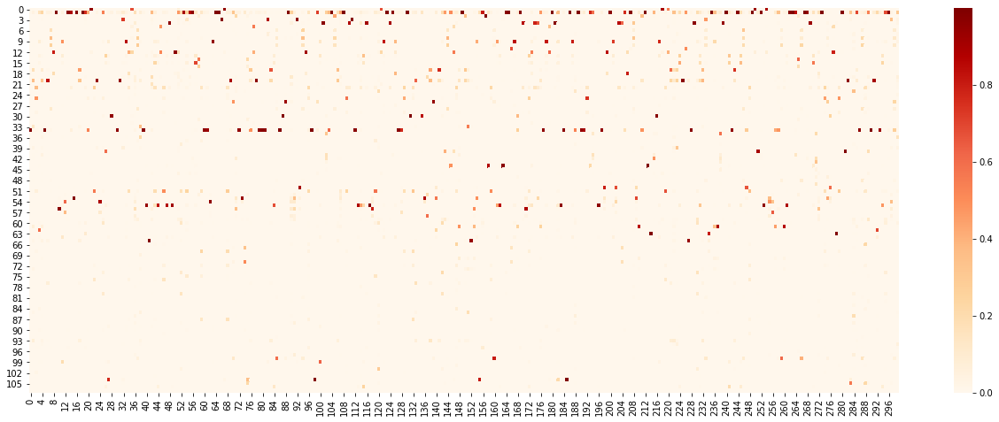

In [76]:
_, ax = plt.subplots(figsize=(22, 8))
# ax.matshow(cm)
sns.heatmap(cm2, cmap="OrRd")
# fig.set_yticklabels(label_name)
# plt.xticks(
#     rotation=90,
#     horizontalalignment='right',
# )
# plt.yticks(
#     rotation=0,
#     horizontalalignment='right',
# )
None

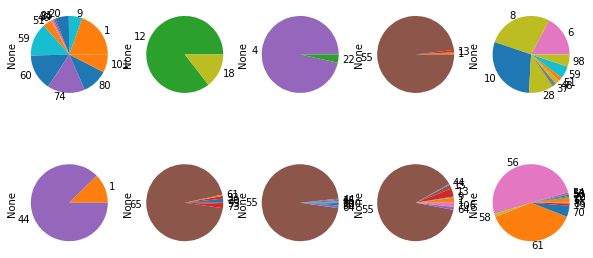

In [94]:
_, axs = plt.subplots(2, 5, figsize=(10, 5))
for i, idx in enumerate(np.random.choice(num_preds, 10)):
    row, col = divmod(i, 5)
    pd.Series(cm[:, idx]).plot(kind='pie', ax=axs[row, col])
plt.savefig('./img/pie_chart.jpg')

<AxesSubplot:>

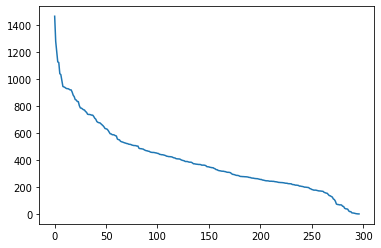

In [89]:
pd.Series(assignments[0].cpu().numpy()).value_counts().sort_values(ascending=False).reset_index(drop=True).plot(kind='line')

In [85]:
from sklearn.metrics.cluster import normalized_mutual_info_score

In [86]:
labels.shape

torch.Size([118926])

In [87]:
normalized_mutual_info_score(assignments[0].cpu().numpy(), labels.cpu().numpy())

0.5693865276753005

In [7]:
def plot(func, yaxis=(-2, 2)):
    x = np.arange(-2, 2, 0.01)
    plt.ylim(yaxis)
    plt.locator_params(nbins=5)
    plt.xticks(fontsize = 14)
    plt.yticks(fontsize = 14)
    plt.axhline(lw=1, c='black')
    plt.axvline(lw=1, c='black')
    plt.grid(alpha=0.4, ls='-.')
    plt.box(on=None)
    plt.plot(x, func(x), c='r', lw=3)

In [17]:
def tanh(x):
    x = x.clip(min=0)
    return 2 / (1 + np.exp(-2 * x)) -1

In [13]:
relu = np.vectorize(lambda x: (x - 0.5) if x - 0.5 > 0 else 0, otypes=[np.float])

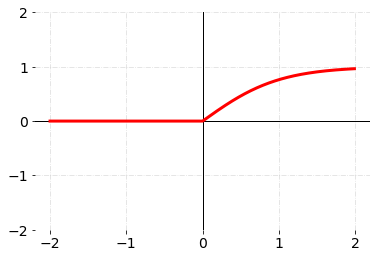

In [18]:
plot(tanh)

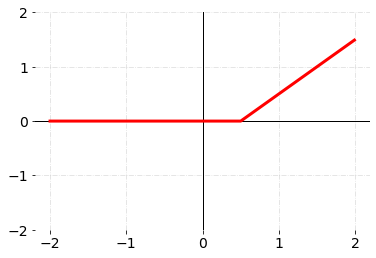

In [14]:
plot(relu)